## A simple GAN 

Using the MNIST dataset on a GAN to generate synthetic numbers.

In [4]:
from keras.datasets.mnist import load_data
import numpy as np
# The test train wont be used and the train will be limited to only one number (5)

(x_train, y_train), (_, _) = load_data()

x_train = x_train[y_train==5,:,:]

print('Train', x_train.shape)

Train (5421, 28, 28)


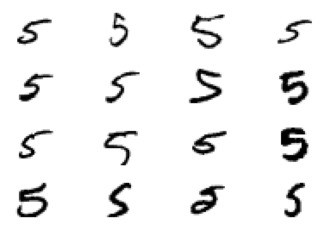

Min and max values:  0 255


In [5]:
import matplotlib.pyplot as plt
for i in range(16):
    plt.subplot(4, 4, 1 + i)
    plt.axis('off')
    plt.imshow(x_train[i+42], cmap='gray_r')
plt.show()

print("Min and max values: ", np.min(x_train[0,:,:]), np.max(x_train[0,:,:]))

## Define the Generator and Discriminator nets

The images are of size 28x28

In [6]:
import torch 
from torch import nn
from torch import optim

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu


In [7]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()

        self.cnn = nn.Sequential(    
            nn.Linear(784, 256),
            nn.LeakyReLU(0.2),
           
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2),
            
            nn.Linear(1024, 784),
            nn.Sigmoid(),
         )
        
    def forward(self, z):    
        out = self.cnn(z)
        return out

In [8]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        # Image starts as a vector of size 784 = 28x28
        self.cnn = nn.Sequential(
            nn.Linear(784, 256),
            nn.LeakyReLU(0.2),
            
            nn.Linear(256, 256),
            nn.LeakyReLU(0.2),
            
            nn.Linear(256, 1),
            nn.Sigmoid()          
        )
        
    def forward(self, x):
        out = self.cnn(x)
        return out.squeeze(1)

In [9]:
discriminator = Discriminator().to(device)
generator = Generator().to(device)

In [10]:
from torchsummary import summary

print("Discriminator:\n")
summary(discriminator, (1,784))
print("\nGenerator:\n")
summary(generator, (1,784))

Discriminator:

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1               [-1, 1, 256]         200,960
         LeakyReLU-2               [-1, 1, 256]               0
            Linear-3               [-1, 1, 256]          65,792
         LeakyReLU-4               [-1, 1, 256]               0
            Linear-5                 [-1, 1, 1]             257
           Sigmoid-6                 [-1, 1, 1]               0
Total params: 267,009
Trainable params: 267,009
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 1.02
Estimated Total Size (MB): 1.03
----------------------------------------------------------------

Generator:

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            

## Auxiliary functions

In [11]:
# Real labels 
def label_real(size):
    data = torch.ones(size)
    return data.to(device)

# Fake labels (0s)
def label_fake(size):
    data = torch.zeros(size)
    return data.to(device)

# Create input noise in Latent space
def create_noise(sample_size, N):
    return torch.randn(sample_size, N).to(device)

## Training functions

In [12]:
# Train discriminator network
def train_discriminator(optimizer, data_real, data_fake):
    
    # Use the same amount of real and fake data 
    n_samples = data_real.shape[0]
    
    optimizer.zero_grad()
    
    output_real = discriminator(data_real)
    loss_real = criterion(output_real, label_real(n_samples))
    
    output_fake = discriminator(data_fake)
    loss_fake = criterion(output_fake, label_fake(n_samples))

    loss_real.backward()
    loss_fake.backward()

    optimizer.step()
    
    return loss_real + loss_fake

In [13]:
# Train generator network
def train_generator(optimizer, data_fake):
    n_samples = data_fake.shape[0]
    
    optimizer.zero_grad()
    
    output = discriminator(data_fake)
    loss = criterion(output, label_real(n_samples))

    loss.backward()
    optimizer.step()
    
    return loss

## Dataset definition

In [14]:
from torch.utils.data import Dataset
# Define DataLoader
class Dataset_(Dataset):
    def __init__(self, data, transform):
        self.transform = transform
        self.data = data
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, index):

        
        image = self.transform(self.data[index, :, :]).reshape((-1,))    
        return image


## Training 

In [18]:
lr = 0.002
epochs = 100
batch_size = 64
img_size = 28 * 28
sample_size = 16
k = 1

# Optimizers
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

# Loss function
criterion = nn.BCELoss()

In [19]:
import torchvision.transforms as transforms
# To tensor converts the values form 0-255 to 0.0-1.0
base_transform = transforms.Compose( [transforms.ToTensor()])

dataset_train = Dataset_(x_train, base_transform) 
train_loader = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, shuffle=True)

In [20]:
# Training loop
from torchvision.utils import make_grid, save_image
from tqdm import tqdm

# Standard Noise vector - to be used as sample for the last epoch
noise_std = create_noise(sample_size, img_size)

generator.train()
discriminator.train()

loss_g = [] 
loss_d = []
images = []
for epoch in range(epochs):
    loss_g_ = 0.0
    loss_d_ = 0.0
    
    for bi, data in enumerate(train_loader): # tqdm(enumerate(train_loader), total=int(x_train.shape[0] / train_loader.batch_size)):
        
        image = data.to(device)
        
        # This works for batch in the 1st dimension
        batch_size_ = len(image)
        
        # Run the discriminator for k number of steps
        for step in range(k):
            
            data_fake = generator(create_noise(batch_size_, img_size)).detach()
            data_real = image
            # Train the discriminator network
            loss_d_ += train_discriminator(optim_d, data_real, data_fake)
            
        data_fake = generator(create_noise(batch_size_, img_size))
        # Train the generator network
        loss_g_ += train_generator(optim_g, data_fake)
    
    # Create the final fake image for the epoch
    generated_img = generator(noise_std).cpu().detach()
    
    # make the images as grid 
    generated_img = make_grid(generated_img).reshape((3,sample_size,28,28))
    
    # print(type(generated_img))
    # print(generated_img.shape)

    # save the generated torch tensor models to disk
    save_image(generated_img[0,0,:,:], f"./output/gen_img{epoch}.png")
    images.append(generated_img)
    
    epoch_loss_g = loss_g_ / bi # total generator loss for the epoch
    epoch_loss_d = loss_d_ / bi # total discriminator loss for the epoch
    
    loss_g.append(epoch_loss_g.item())
    loss_d.append(epoch_loss_d.item())
    
    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")


Epoch 1 of 100
Generator loss: 52.97220993, Discriminator loss: 0.00003525
Epoch 2 of 100
Generator loss: 54.88649368, Discriminator loss: 0.00000000
Epoch 3 of 100
Generator loss: 54.85448074, Discriminator loss: 0.00000000
Epoch 4 of 100
Generator loss: 42.86392975, Discriminator loss: 10.85280037
Epoch 5 of 100
Generator loss: 31.87279892, Discriminator loss: 1.48143840
Epoch 6 of 100
Generator loss: 30.83491516, Discriminator loss: 0.06296822
Epoch 7 of 100
Generator loss: 23.99050903, Discriminator loss: 0.04641468
Epoch 8 of 100
Generator loss: 20.81365013, Discriminator loss: 0.00467410
Epoch 9 of 100
Generator loss: 18.46349716, Discriminator loss: 0.00420765
Epoch 10 of 100
Generator loss: 10.90670013, Discriminator loss: 0.00612866
Epoch 11 of 100
Generator loss: 11.44574261, Discriminator loss: 0.00358463
Epoch 12 of 100
Generator loss: 13.12146282, Discriminator loss: 0.00255380
Epoch 13 of 100
Generator loss: 15.87359810, Discriminator loss: 0.00131385
Epoch 14 of 100
Gene

## Plot losses

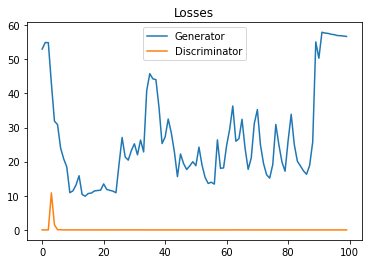

In [21]:
import matplotlib.pyplot as plt

plt.plot(loss_g)
plt.plot(loss_d)
plt.title("Losses")
plt.legend(["Generator", "Discriminator"])
plt.show()

## Visualize results

In [94]:
# Create a Gif for all the epochs
frame = np.zeros((epochs, 28*4, 28*4, 3))
for ep_sample in range(epochs):
    #print(f"Generated samples for epoch {ep_sample+1}")
    img = images[ep_sample][0,:,:,:]
    k = 0
    for i in range(4):
        for j in range(4):
            # Is done 3 times for the gif library
            frame[ep_sample, i*28:(i+1)*28, j*28:(j+1)*28,0] = img[k,:,:] * 255
            frame[ep_sample, i*28:(i+1)*28, j*28:(j+1)*28,1] = img[k,:,:] * 255
            frame[ep_sample, i*28:(i+1)*28, j*28:(j+1)*28,2] = img[k,:,:] * 255
            k = k + 1


In [103]:
# Save the gif
from moviepy.editor import ImageSequenceClip

frame_l = []
for k in range(epochs):
    frame_l.append(frame[k,:,:])

clip = ImageSequenceClip(frame_l, fps=8)
clip = clip.resize((720,720))
clip.write_gif('output_gif.gif', fps=20)

t:   1%|          | 3/250 [00:00<00:11, 21.99it/s, now=None]

MoviePy - Building file output_gif.gif with imageio.


In [104]:
from IPython.display import display, Image
Image('output_gif.gif')

Generated samples for epoch 1


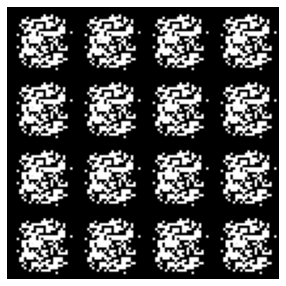

Generated samples for epoch 100


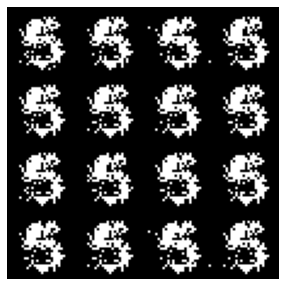

In [82]:
epoch_samples = [1,100]

for ep_sample in epoch_samples:
    print(f"Generated samples for epoch {ep_sample}")

    _, axs = plt.subplots(figsize=(5, 5))
    axs.imshow(frame[ep_sample-1,:,:])
    axs.set_axis_off()  
        
    plt.show()

## Other definitions of the models

In [16]:
# Other possible discriminator examples to try:
'''
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        # Image starts at 28x28
        self.cnn = nn.Sequential(
            nn.Conv2d(1, 8, kernel_size = 3, stride = 2, bias = False),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            # 14x14
            nn.Conv2d(8, 16, kernel_size = 3, stride = 2, bias = False),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            # 7x7
            nn.Conv2d(16, 32, kernel_size = 3, stride = 2, bias = False),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.Flatten(),
            nn.Linear(128, 64),
            nn.Sigmoid(),
            nn.ReLU(),
            
            nn.Linear(64, 16),
            nn.Sigmoid(),
            nn.ReLU(),

            nn.Linear(16, 1),
            nn.Sigmoid()            
        )
        
    def forward(self, x):
        out = self.cnn(x)
        return out.squeeze(1)
'''

'\nclass Discriminator(nn.Module):\n    def __init__(self):\n        super().__init__()\n        # Image starts at 28x28\n        self.cnn = nn.Sequential(\n            nn.Conv2d(1, 8, kernel_size = 3, stride = 2, bias = False),\n            nn.BatchNorm2d(8),\n            nn.ReLU(),\n            # 14x14\n            nn.Conv2d(8, 16, kernel_size = 3, stride = 2, bias = False),\n            nn.BatchNorm2d(16),\n            nn.ReLU(),\n            # 7x7\n            nn.Conv2d(16, 32, kernel_size = 3, stride = 2, bias = False),\n            nn.BatchNorm2d(32),\n            nn.ReLU(),\n            \n            nn.Flatten(),\n            nn.Linear(128, 64),\n            nn.Sigmoid(),\n            nn.ReLU(),\n            \n            nn.Linear(64, 16),\n            nn.Sigmoid(),\n            nn.ReLU(),\n\n            nn.Linear(16, 1),\n            nn.Sigmoid()            \n        )\n        \n    def forward(self, x):\n        out = self.cnn(x)\n        return out.squeeze(1)\n'